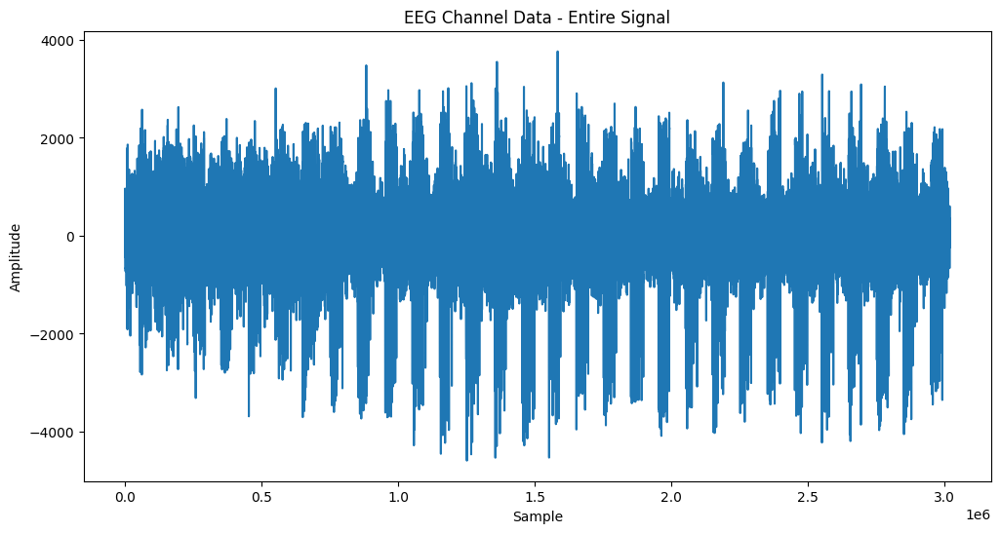

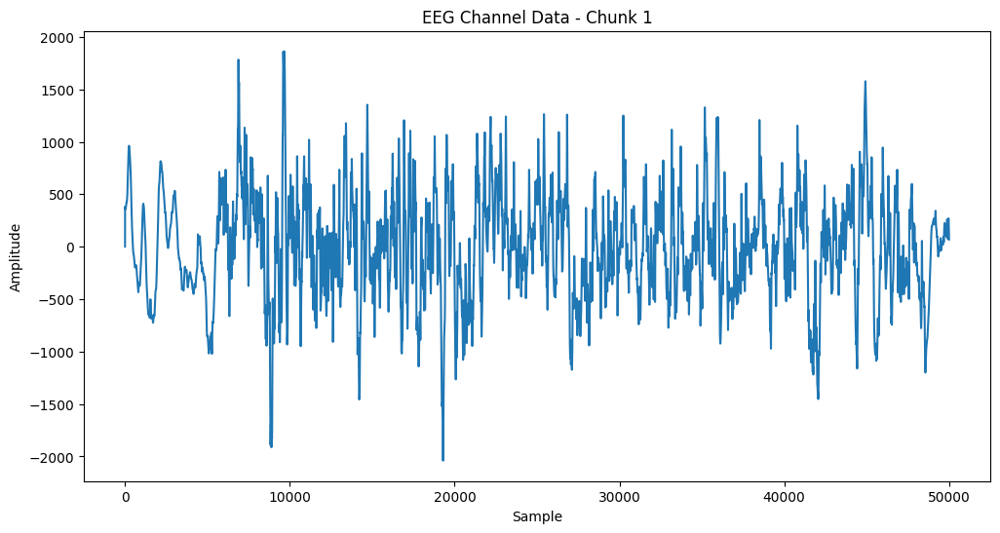

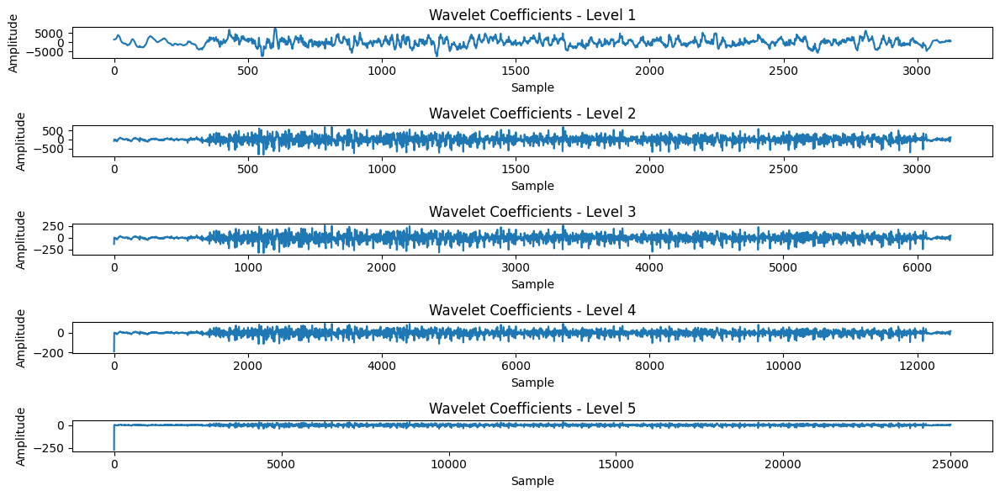

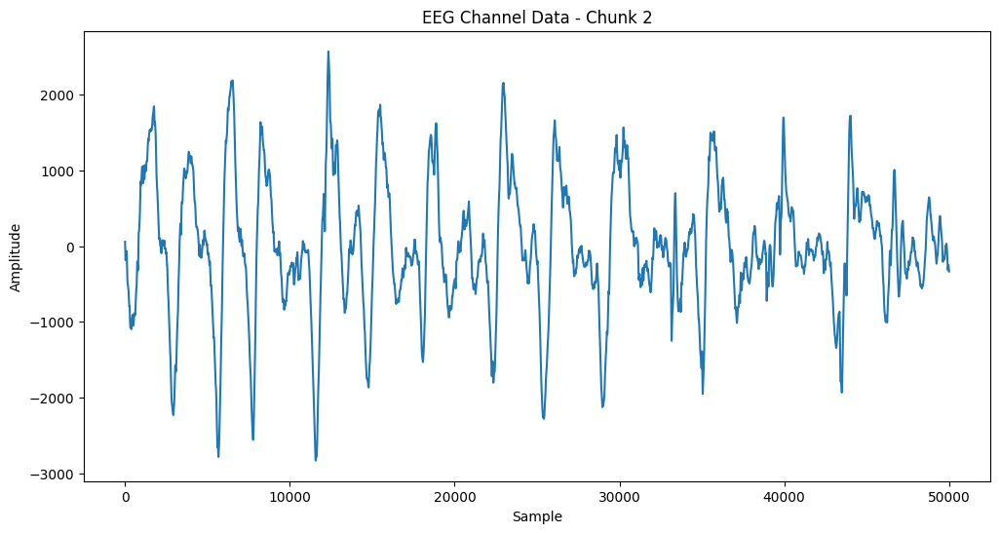

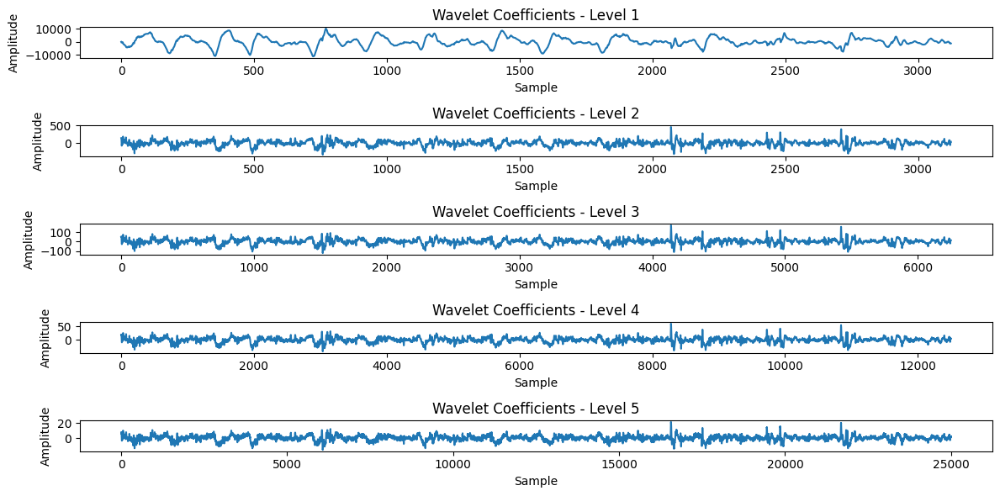

...

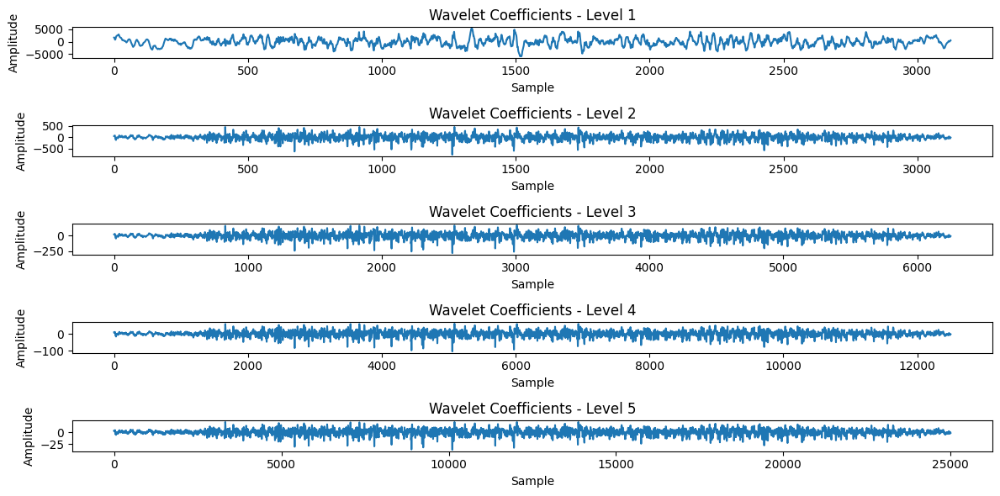

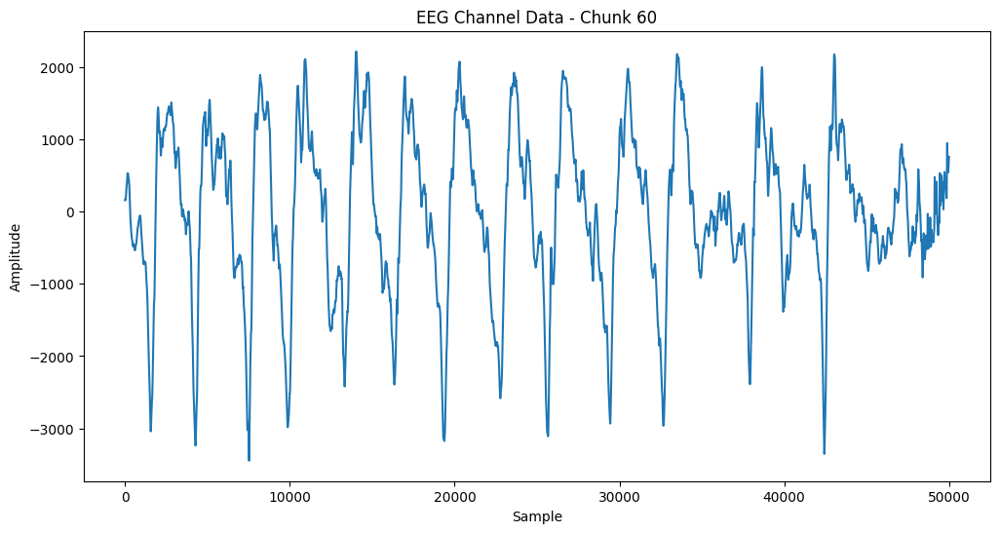

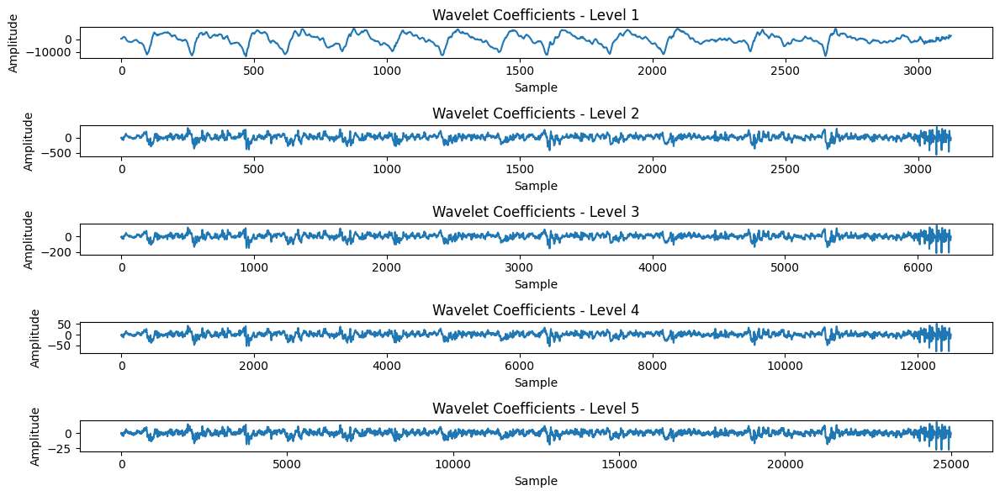

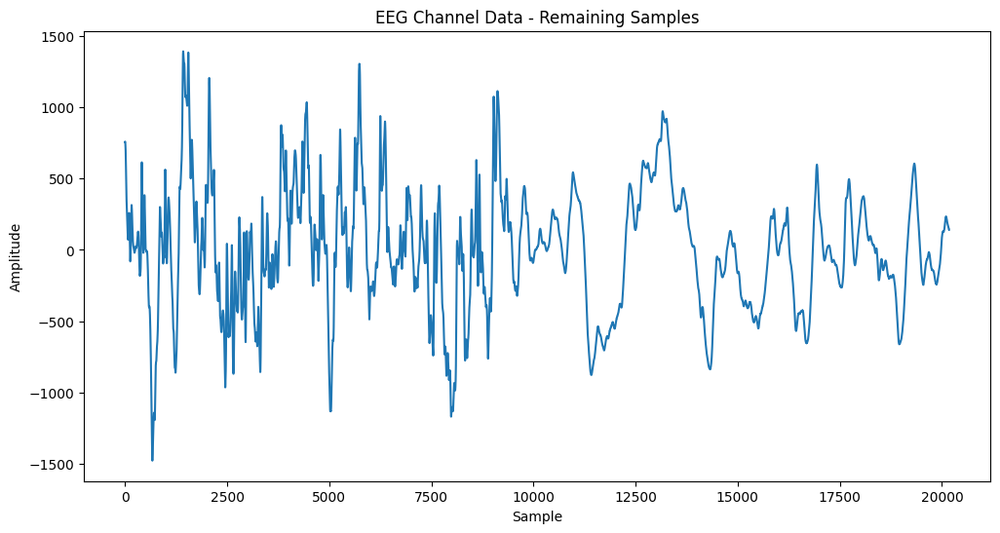

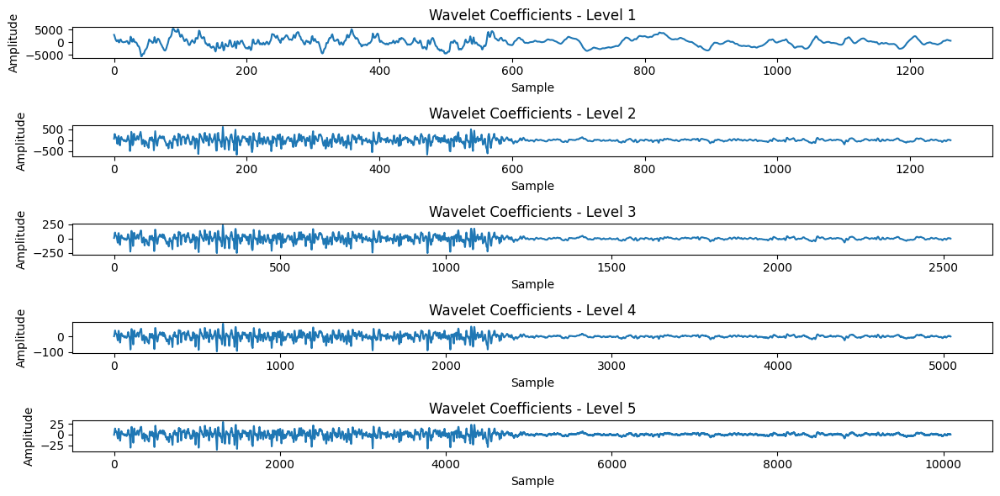

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import pywt
import numpy as np

# Function to perform wavelet transform on a given signal
def wavelet_transform(signal, wavelet='db1', level=4):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    return coeffs

# Function to read data from CSV file and visualize it
def visualize_eeg_data(file_path):
    # Read data from CSV file with no headers
    df = pd.read_csv(file_path, header=None)
    
    # Extract EEG channel data
    eeg_data = df.iloc[:, 0].values
    
    # Visualize the entire EEG data
    plt.figure(figsize=(12, 6))
    plt.plot(eeg_data)
    plt.title('EEG Channel Data - Entire Signal')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')
    plt.show()

    # Visualize EEG data in chunks of 5 seconds
    sampling_rate = 10000  # Assuming a sampling rate of 10 kHz
    chunk_size = 5 * sampling_rate  # 5 seconds

    num_chunks = len(eeg_data) // chunk_size
    remainder_samples = len(eeg_data) % chunk_size

    for i in range(num_chunks):
        start_idx = i * chunk_size
        end_idx = (i + 1) * chunk_size
        chunk_data = eeg_data[start_idx:end_idx]

        plt.figure(figsize=(12, 6))
        plt.plot(chunk_data)
        plt.title(f'EEG Channel Data - Chunk {i + 1}')
        plt.xlabel('Sample')
        plt.ylabel('Amplitude')
        plt.show()

        # Perform wavelet transform on the chunk
        coeffs = wavelet_transform(chunk_data)
        # Visualize the wavelet coefficients
        plt.figure(figsize=(12, 6))
        for j, coeff in enumerate(coeffs):
            plt.subplot(len(coeffs), 1, j + 1)
            plt.plot(coeff)
            plt.title(f'Wavelet Coefficients - Level {j + 1}')
            plt.xlabel('Sample')
            plt.ylabel('Amplitude')
        plt.tight_layout()
        plt.show()

    # Visualize the remaining samples (if any)
    if remainder_samples > 0:
        remaining_data = eeg_data[-remainder_samples:]
        plt.figure(figsize=(12, 6))
        plt.plot(remaining_data)
        plt.title('EEG Channel Data - Remaining Samples')
        plt.xlabel('Sample')
        plt.ylabel('Amplitude')
        plt.show()

        # Perform wavelet transform on the remaining samples
        coeffs = wavelet_transform(remaining_data)
        # Visualize the wavelet coefficients
        plt.figure(figsize=(12, 6))
        for j, coeff in enumerate(coeffs):
            plt.subplot(len(coeffs), 1, j + 1)
            plt.plot(coeff)
            plt.title(f'Wavelet Coefficients - Level {j + 1}')
            plt.xlabel('Sample')
            plt.ylabel('Amplitude')
        plt.tight_layout()
        plt.show()

# Replace 'your_data.csv' with the actual path to your CSV file
visualize_eeg_data(r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Blink_5mins.csv")


                                              0.0/4.3 MB ? eta -:--:--
                                              0.0/4.3 MB ? eta -:--:--
     -                                        0.1/4.3 MB 1.6 MB/s eta 0:00:03
     -                                        0.2/4.3 MB 1.7 MB/s eta 0:00:03
     -                                        0.2/4.3 MB 1.7 MB/s eta 0:00:03
     ----                                     0.5/4.3 MB 2.2 MB/s eta 0:00:02
     ----                                     0.5/4.3 MB 2.2 MB/s eta 0:00:02
     -----                                    0.5/4.3 MB 1.8 MB/s eta 0:00:03
     -----                                    0.6/4.3 MB 1.8 MB/s eta 0:00:02
     ------                                   0.6/4.3 MB 1.6 MB/s eta 0:00:03
     -------                                  0.8/4.3 MB 1.8 MB/s eta 0:00:02
     -------                                  0.8/4.3 MB 1.7 MB/s eta 0:00:03
     -------                                  0.8/4.3 MB 1.7 MB/s eta 0:00:03



[notice] A new release of pip is available: 23.1.2 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [30]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
c=random.randint(2000,100000)
# Function to read data from CSV file and visualize it
def visualize_eeg_data(file_path, output_folder):
    # Read data from CSV file with no headers
    df = pd.read_csv(file_path, header=None)
    
    # Extract EEG channel data
    eeg_data = df.iloc[:, 0].values
    
    # Create output folders if they don't exist
    even_chunk_folder = os.path.join(output_folder, 'even_chunks')
    odd_chunk_folder = os.path.join(output_folder, 'odd_chunks')
    
    os.makedirs(even_chunk_folder, exist_ok=True)
    os.makedirs(odd_chunk_folder, exist_ok=True)

    # Visualize EEG data in chunks of 5 seconds
    sampling_rate = 10000  # Assuming a sampling rate of 10 kHz
    chunk_size = 5 * sampling_rate  # 5 seconds

    num_chunks = len(eeg_data) // chunk_size
    remainder_samples = len(eeg_data) % chunk_size

    for i in range(num_chunks):
        start_idx = i * chunk_size
        end_idx = (i + 1) * chunk_size
        chunk_data = eeg_data[start_idx:end_idx]

        plt.figure(figsize=(12, 6))
        plt.plot(chunk_data)
        plt.title(f'EEG Channel Data - Chunk {i + 1}')
        plt.xlabel('Sample')
        plt.ylabel('Amplitude')

        # Save the plot based on even or odd index
        if i % 2 == 0:
            plt.savefig(os.path.join(even_chunk_folder, f'Even_chunk_{c + i}.png'))
        else:
            plt.savefig(os.path.join(odd_chunk_folder, f'Odd_chunk_{c + i}.png'))

        plt.close()

    # Visualize the remaining samples (if any)
    if remainder_samples > 0:
        remaining_data = eeg_data[-remainder_samples:]
        plt.figure(figsize=(12, 6))
        plt.plot(remaining_data)
        plt.title('EEG Channel Data - Remaining Samples')
        plt.xlabel('Sample')
        plt.ylabel('Amplitude')

        # Save the remaining samples plot
        plt.savefig(os.path.join(output_folder, 'remaining_samples.png'))
        plt.close()
        
# Replace 'your_data.csv' with the actual path to your CSV file
# Replace 'output_folder' with the desired folder to save the plots
visualize_eeg_data(r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Rest_5mins_2.csv", r'D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Visual_Images')


In [31]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Directory containing EEG graph images
data_directory = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Visual_Images"  # Replace with the path to your EEG graph images
num_classes = 2  # Adjust based on the number of classes (e.g., even and odd)

# Image dimensions
img_width, img_height = 1200, 600  # Adjust based on your image size

# Data augmentation to generate more training samples
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2
)

# Load and preprocess images from subfolders
train_generator = train_datagen.flow_from_directory(
    data_directory,
    target_size=(img_width, img_height),
    batch_size=32,
    class_mode='categorical',  # Assumes you have two classes
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_directory,
    target_size=(img_width, img_height),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

# Define the CNN model
model = Sequential([
    Conv2D(32, (3, 3), input_shape=(img_width, img_height, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=10,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size
)


Found 241 images belonging to 2 classes.
Found 59 images belonging to 2 classes.
Epoch 1/10
7/7 [==============================] - 238s 33s/step - loss: 93.6038 - accuracy: 0.4777 - val_loss: 10.4460 - val_accuracy: 0.5000
Epoch 2/10
7/7 [==============================] - 210s 33s/step - loss: 5.7366 - accuracy: 0.5933 - val_loss: 0.1973 - val_accuracy: 0.9375
Epoch 3/10
7/7 [==============================] - 211s 29s/step - loss: 0.2973 - accuracy: 0.8804 - val_loss: 0.0492 - val_accuracy: 1.0000
Epoch 4/10
7/7 [==============================] - 218s 29s/step - loss: 0.4028 - accuracy: 0.8373 - val_loss: 0.4250 - val_accuracy: 0.7500
Epoch 5/10
7/7 [==============================] - 256s 37s/step - loss: 0.4282 - accuracy: 0.7943 - val_loss: 0.3740 - val_accuracy: 0.8438
Epoch 6/10
7/7 [==============================] - 224s 29s/step - loss: 0.3626 - accuracy: 0.8421 - val_loss: 0.1355 - val_accuracy: 1.0000
Epoch 7/10
7/7 [==============================] - 268s 35s/step - loss: 0.195

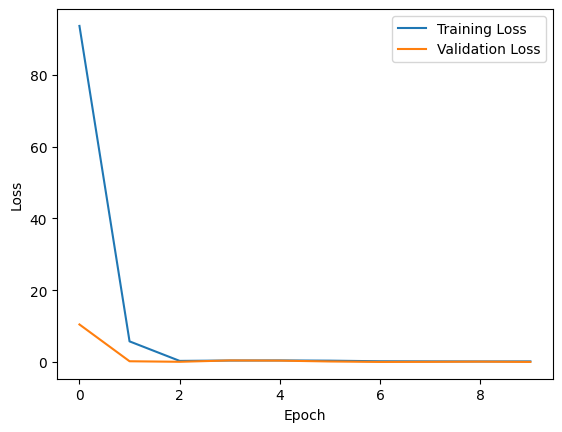

2/2 [==============================] - 10s 4s/step
Classification Report:
              precision    recall  f1-score   support

           0       0.68      0.70      0.69        33
           1       0.60      0.58      0.59        26

    accuracy                           0.64        59
   macro avg       0.64      0.64      0.64        59
weighted avg       0.64      0.64      0.64        59

Confusion Matrix:
[[23 10]
 [11 15]]


In [33]:
from sklearn.metrics import classification_report, confusion_matrix
# Plot training and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the validation set
validation_results = model.evaluate(validation_generator, steps=validation_generator.samples // validation_generator.batch_size)

# Make predictions on the validation set
y_pred = model.predict(validation_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# True labels
y_true = validation_generator.classes

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

print("Confusion Matrix:")
print(confusion_matrix(y_true, y_pred_classes))

Found 241 images belonging to 2 classes.
Found 59 images belonging to 2 classes.
Epoch 1/6
7/7 [==============================] - 160s 25s/step - loss: 83.4370 - accuracy: 0.4641 - val_loss: 2.6536 - val_accuracy: 0.6250
Epoch 2/6
7/7 [==============================] - 169s 23s/step - loss: 2.7128 - accuracy: 0.6938 - val_loss: 0.1111 - val_accuracy: 0.9688
Epoch 3/6
7/7 [==============================] - 163s 25s/step - loss: 0.3847 - accuracy: 0.8995 - val_loss: 0.0903 - val_accuracy: 1.0000
Epoch 4/6
7/7 [==============================] - 156s 22s/step - loss: 0.5349 - accuracy: 0.8469 - val_loss: 0.4400 - val_accuracy: 0.7500
Epoch 5/6
7/7 [==============================] - 169s 22s/step - loss: 0.3377 - accuracy: 0.8900 - val_loss: 0.2380 - val_accuracy: 0.9062
Epoch 6/6
7/7 [==============================] - 162s 23s/step - loss: 0.1406 - accuracy: 0.9665 - val_loss: 0.1783 - val_accuracy: 0.9375


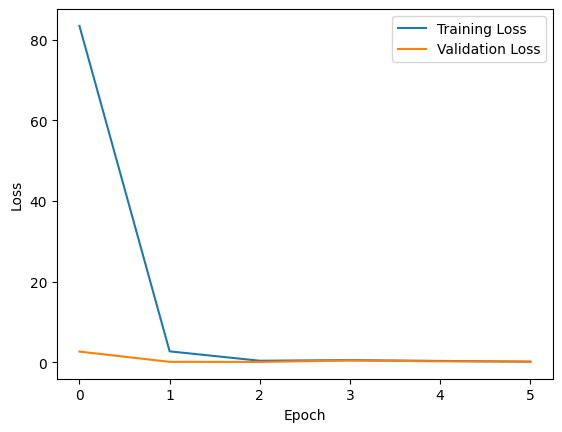

2/2 [==============================] - 5s 2s/step
Classification Report:
              precision    recall  f1-score   support

           0       0.51      0.55      0.53        33
           1       0.38      0.35      0.36        26

    accuracy                           0.46        59
   macro avg       0.44      0.45      0.44        59
weighted avg       0.45      0.46      0.45        59

Confusion Matrix:
[[18 15]
 [17  9]]


In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Directory containing EEG graph images
data_directory = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Visual_Images"  # Replace with the path to your EEG graph images
num_classes = 2  # Adjust based on the number of classes (e.g., even and odd)

train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)
# Image dimensions
img_width, img_height = 1200, 600  # Adjust based on your image size

# Data augmentation to generate more training samples
# train_datagen = ImageDataGenerator(
#     rescale=1./255,
#     shear_range=0.2,
#     zoom_range=0.2,
#     horizontal_flip=True,
#     validation_split=0.2
# )

# Load and preprocess images from subfolders
train_generator = train_datagen.flow_from_directory(
    data_directory,
    target_size=(img_width, img_height),
    batch_size=32,
    class_mode='categorical',  # Assumes you have two classes
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_directory,
    target_size=(img_width, img_height),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

# Define the CNN model
model = Sequential([
    Conv2D(32, (3, 3), input_shape=(img_width, img_height, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=6,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size
)


from sklearn.metrics import classification_report, confusion_matrix
# Plot training and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluate the model on the validation set
validation_results = model.evaluate(validation_generator, steps=validation_generator.samples // validation_generator.batch_size)

# Make predictions on the validation set
y_pred = model.predict(validation_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# True labels
y_true = validation_generator.classes

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

print("Confusion Matrix:")
print(confusion_matrix(y_true, y_pred_classes))

In [1]:
import pandas as pd
import numpy as np
from scipy.stats import mode
from scipy.signal import welch

def calculate_statistics(row):
    # Calculate mean, max, and min
    mean_value = np.mean(row)
    max_value = np.max(row)
    min_value = np.min(row)

    # Calculate Common Space Mode (CSP)
    csp_value, _ = mode(row)

    return mean_value, max_value, min_value, csp_value[0]

def calculate_psd(row, sampling_rate):
    # Calculate Power Spectral Density (PSD)
    f, psd = welch(row, fs=sampling_rate, nperseg=len(row))

    return f, psd

def process_transposed_file(file_path, sampling_rate):
    try:
        # Read the transposed file
        df = pd.read_csv(file_path, header=None)

        # Iterate over each row
        for index, row in df.iterrows():
            mean_value, max_value, min_value, csp_value = calculate_statistics(row)
            f, psd = calculate_psd(row, sampling_rate)

            # Print the results for each row
            print(f"Row {index + 1}:")
            print(f"  Mean: {mean_value}")
            print(f"  Max: {max_value}")
            print(f"  Min: {min_value}")
            print(f"  CSP (Common Space Mode): {csp_value}")
            print(f"  Power Spectral Density (PSD):")
            for freq, power in zip(f, psd):
                print(f"    Frequency: {freq} Hz, Power: {power}")
            print("\n")

    except Exception as e:
        print(f"Error reading {file_path}: {e}")

# Example usage
transposed_file_path = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\Jose_Jaw_Blink_5mins_10secs_merged.csv"
sampling_rate = 10000  # Replace with the actual sampling rate of your data

process_transposed_file(transposed_file_path, sampling_rate)


Error reading D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\Jose_Jaw_Blink_5mins_10secs_merged.csv: unsupported operand type(s) for +: 'int' and 'str'


In [41]:
import pandas as pd
data = pd.read_csv(r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Blink_5mins_transposed.csv")
data.head(25)

,0,382,382.1,381,380,379,379.1,377,377.1,375,...,139.39,130.28,122.35,114.50,105.41,96.32,87.38,77.54,68.35,JAW
0,59,49,40,31,22,13,4,-4,-13,-22,...,-315,-318,-320,-323,-324,-327,-330,-332,-335,BLINK
1,-338,-339,-342,-343,-346,-348,-349,-351,-352,-354,...,848,841,834,827,820,814,807,801,795,JAW
2,790,785,781,777,773,771,769,767,765,765,...,204,200,197,193,190,185,182,178,175,BLINK
3,172,169,165,162,159,156,154,152,150,147,...,-104,-111,-118,-124,-129,-135,-141,-147,-153,JAW
4,-159,-165,-172,-179,-185,-193,-201,-210,-218,-226,...,-467,-467,-468,-469,-470,-470,-471,-470,-470,BLINK
5,-470,-470,-470,-469,-469,-468,-468,-466,-466,-465,...,-882,-882,-881,-882,-882,-882,-883,-884,-886,JAW
6,-889,-893,-897,-903,-908,-915,-922,-929,-937,-946,...,-351,-357,-365,-374,-382,-392,-403,-415,-427,BLINK
7,-440,-453,-464,-476,-485,-494,-500,-504,-507,-507,...,-199,-213,-226,-239,-253,-267,-280,-292,-305,JAW
8,-316,-327,-337,-346,-354,-362,-367,-372,-375,-378,...,-80,-79,-79,-79,-79,-79,-80,-79,-80,BLINK
9,-80,-81,-82,-83,-84,-85,-86,-86,-86,-87,...,-653,-654,-654,-654,-654,-654,-654,-653,-652,JAW


In [5]:
import pandas as pd
import numpy as np
import pywt

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"  # Replace with the path to your CSV file
data = pd.read_csv(input_file,nrows=20)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Calculate statistics for each row
row_statistics = []
for idx, row in enumerate(eeg_data):
    # Calculate mean, max, and min for each row
    row_mean = np.mean(row)
    row_max = np.max(row)
    row_min = np.min(row)
    
    # Wavelet Transform
    coeffs = pywt.wavedec(row, 'db1', level=5)  # Adjust the wavelet and level as needed
    row_wavelet = np.concatenate(coeffs)
    
    # Append results to the list
    row_statistics.append({'Row': idx + 1, 'Mean': row_mean, 'Max': row_max, 'Min': row_min, 'Wavelet': row_wavelet})

# Create a DataFrame from the list of dictionaries
result_df = pd.DataFrame(row_statistics)

# Print the result
print(result_df)


    Row       Mean   Max   Min  \
0     1  267.63875  1669  -498   
1     2  109.08005  1165  -745   
2     3   59.19500   978 -1084   
3     4  209.56185   995  -630   
4     5  238.95415  2401 -2284   
5     6  221.16630  1320 -1344   
6     7  271.28745  1586 -1386   
7     8   80.61710  1613 -2400   
8     9  240.84830  1645 -1427   
9    10  177.17225  1598  -933   
10   11  187.45360   874  -678   
11   12  159.28855   701  -582   
12   13  166.14245   949  -883   
13   14  215.63005   923  -617   
14   15   62.58570  2269 -2583   
15   16 -302.21620  2084 -4413   
16   17  360.03390  2186 -2369   
17   18  276.97640  1471 -1681   
18   19  238.59340  1355 -1397   
19   20  174.19420  1052 -1007   

                                              Wavelet  
0   [-734.6839456528232, 8.662058069535192, 281.95...  
1   [1391.5861453751259, 2469.2168799034253, 2843....  
2   [-558.4375804420761, -650.8917920822172, -907....  
3   [818.1225458328358, 989.2423868799804, 877.342...  
4   [

In [7]:
import pandas as pd
import numpy as np
from scipy.stats import entropy
from scipy.signal import welch
import pywt

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"  # Replace with the path to your CSV file
data = pd.read_csv(input_file, header=None,nrows=20)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Sampling frequency
fs = 10000  # Adjust as needed based on your actual sampling frequency

# Initialize lists to store calculated features
mean_values = []
std_dev_values = []
power_spectral_density = []
entropy_values = []
wavelet_transform = []

# Loop through each row
for idx, row in enumerate(eeg_data):
    # Mean (Time-domain feature)
    mean_values.append(np.mean(row))

    # Standard Deviation (Time-domain feature)
    std_dev_values.append(np.std(row))

    # Power Spectral Density (Frequency-domain feature)
    frequencies, psd = welch(row, fs=fs, nperseg=512)
    power_spectral_density.append(psd)

    # Entropy (Statistical feature)
    entropy_values.append(entropy(row))

    # Wavelet Transform
    coeffs = pywt.wavedec(row, 'db1', level=5)  # Adjust the wavelet and level as needed
    wavelet_transform.append(np.concatenate(coeffs))

# Create a DataFrame from the calculated features
features_df = pd.DataFrame({
    'Mean': mean_values,
    'StandardDeviation': std_dev_values,
    'PowerSpectralDensity': power_spectral_density,
    'Entropy': entropy_values,
    'WaveletTransform': wavelet_transform
})

# Print or display the DataFrame
print(features_df)


         Mean  StandardDeviation  \
0   368.77395         416.761072   
1   267.63875         378.759875   
2   109.08005         339.477208   
3    59.19500         417.419458   
4   209.56185         302.559983   
5   238.95415         989.093743   
6   221.16630         646.094208   
7   271.28745         655.147290   
8    80.61710         811.205186   
9   240.84830         637.352745   
10  177.17225         385.142442   
11  187.45360         274.604779   
12  159.28855         250.480318   
13  166.14245         280.503072   
14  215.63005         264.643233   
15   62.58570        1136.124813   
16 -302.21620        1394.433349   
17  360.03390         974.293360   
18  276.97640         654.865390   
19  238.59340         636.776917   

                                 PowerSpectralDensity  Entropy  \
0   [155.15788289375186, 1214.5117180031984, 487.2...     -inf   
1   [356.53422929311677, 1704.4018706349113, 721.3...     -inf   
2   [357.31035250449503, 1356.058018328218, 5

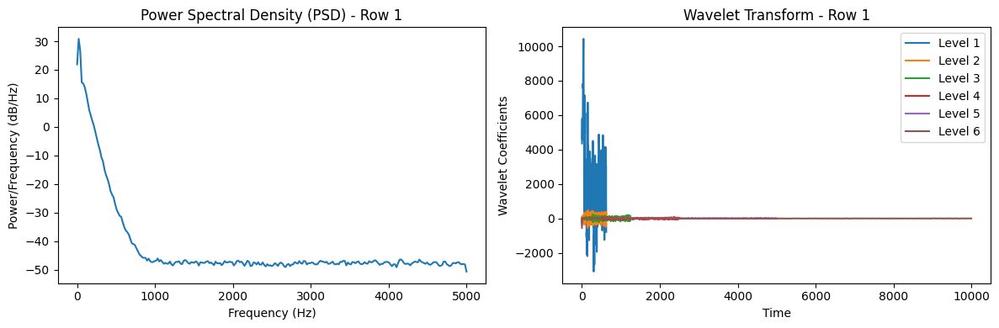

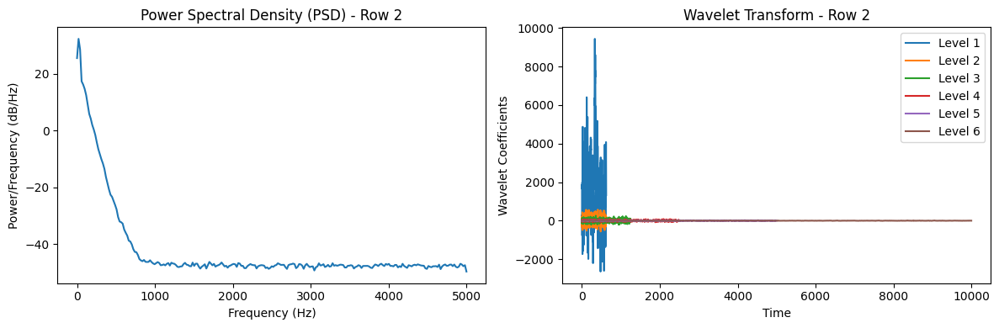

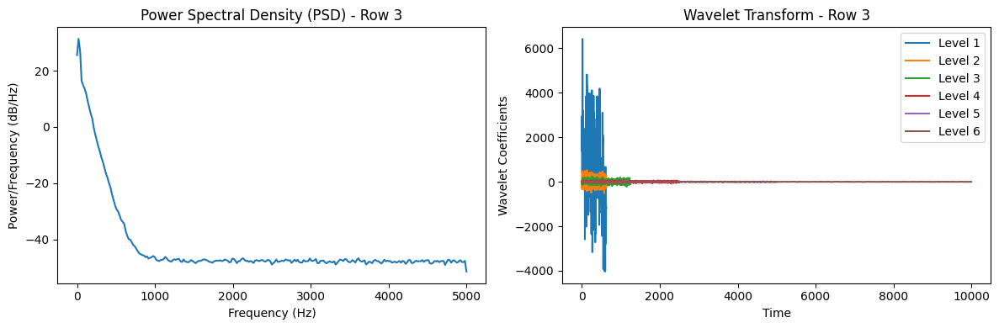

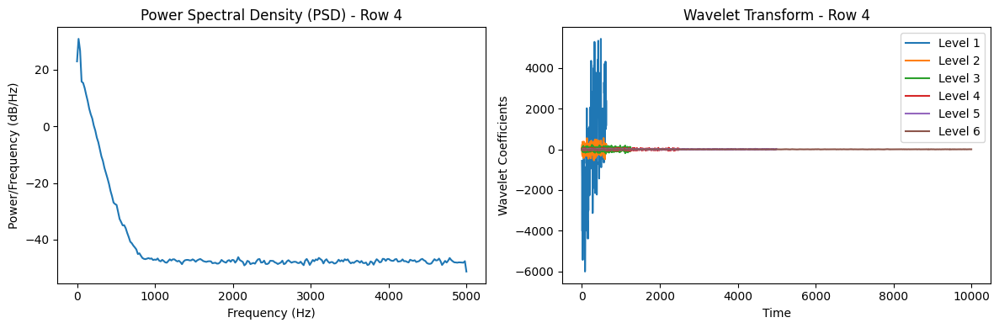

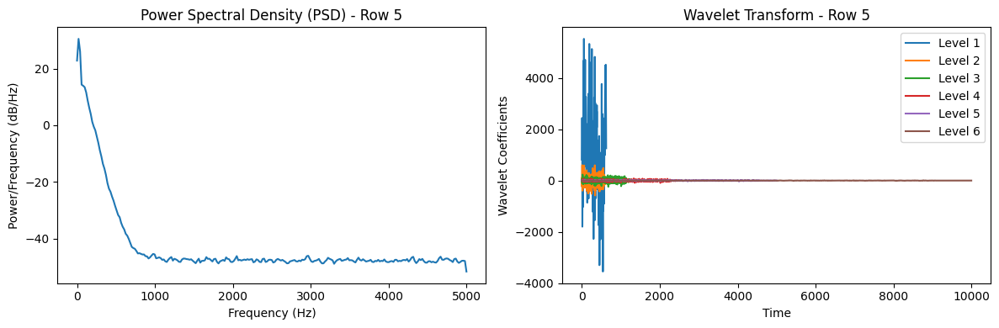

...

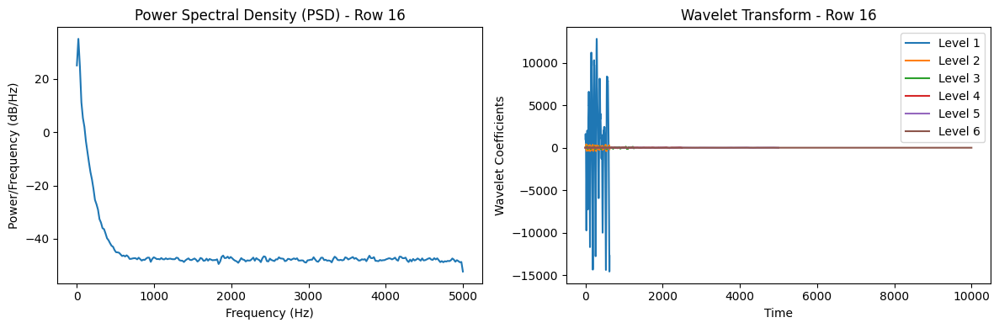

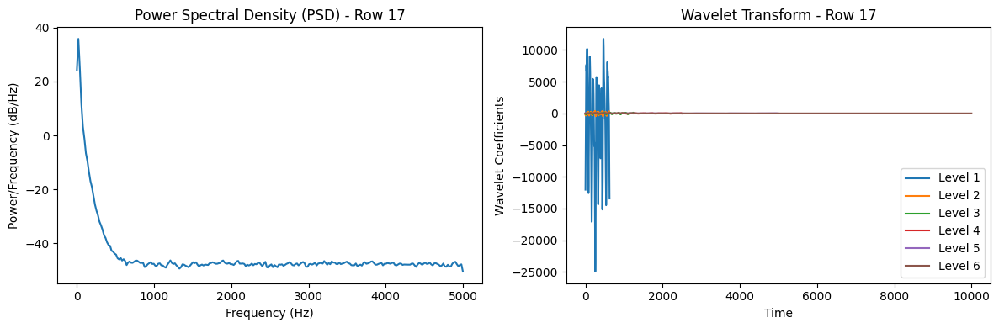

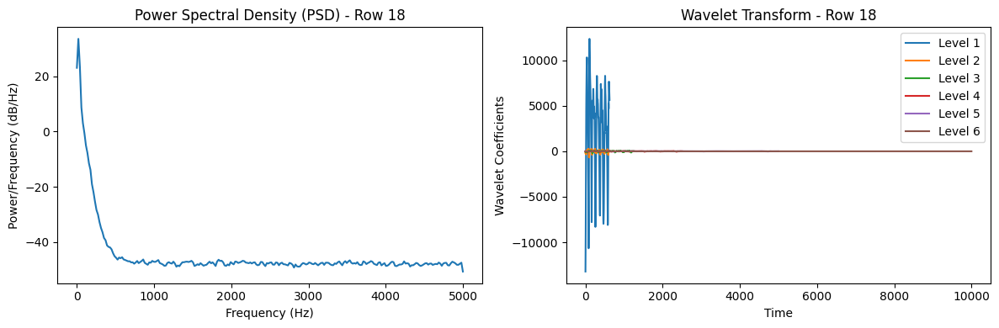

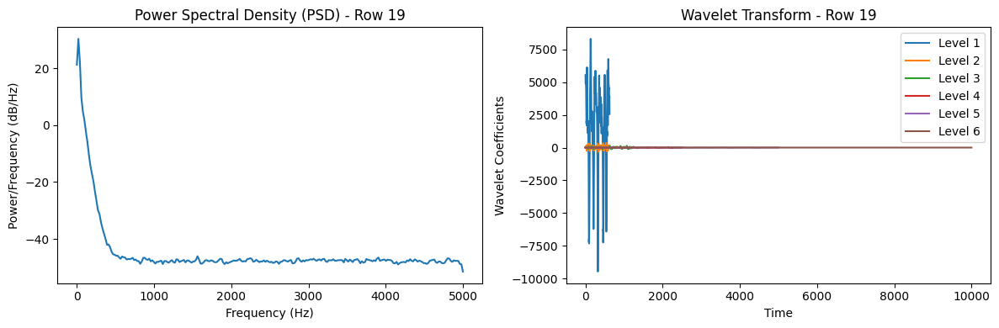

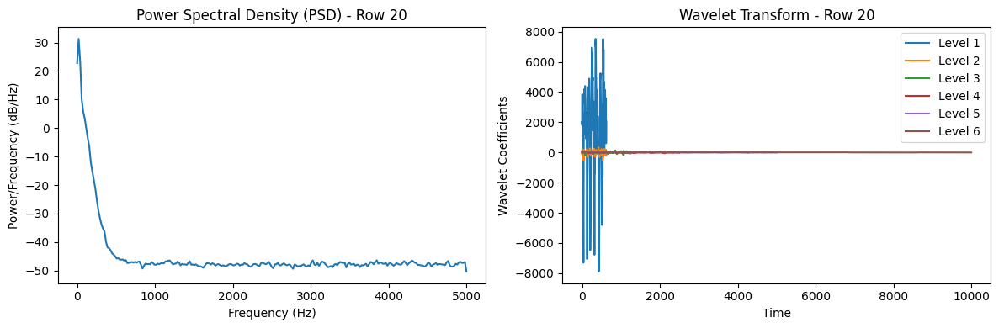

         Mean  StandardDeviation  \
0   368.77395         416.761072   
1   267.63875         378.759875   
2   109.08005         339.477208   
3    59.19500         417.419458   
4   209.56185         302.559983   
5   238.95415         989.093743   
6   221.16630         646.094208   
7   271.28745         655.147290   
8    80.61710         811.205186   
9   240.84830         637.352745   
10  177.17225         385.142442   
11  187.45360         274.604779   
12  159.28855         250.480318   
13  166.14245         280.503072   
14  215.63005         264.643233   
15   62.58570        1136.124813   
16 -302.21620        1394.433349   
17  360.03390         974.293360   
18  276.97640         654.865390   
19  238.59340         636.776917   

                                 PowerSpectralDensity  Entropy  \
0   [155.15788289375186, 1214.5117180031984, 487.2...     -inf   
1   [356.53422929311677, 1704.4018706349113, 721.3...     -inf   
2   [357.31035250449503, 1356.058018328218, 5

In [10]:
import pandas as pd
import numpy as np
from scipy.stats import entropy
from scipy.signal import welch
import pywt
import matplotlib.pyplot as plt

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"  # Replace with the path to your CSV file
data = pd.read_csv(input_file, header=None,nrows=20)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Sampling frequency
fs = 10000  # Adjust as needed based on your actual sampling frequency

# Initialize lists to store calculated features
mean_values = []
std_dev_values = []
power_spectral_density = []
entropy_values = []
wavelet_transform = []

# Loop through each row
for idx, row in enumerate(eeg_data):
    # Mean (Time-domain feature)
    mean_values.append(np.mean(row))

    # Standard Deviation (Time-domain feature)
    std_dev_values.append(np.std(row))

    # Power Spectral Density (Frequency-domain feature)
    frequencies, psd = welch(row, fs=fs, nperseg=512)
    power_spectral_density.append(psd)

    # Entropy (Statistical feature)
    entropy_values.append(entropy(row))

    # Wavelet Transform
    coeffs = pywt.wavedec(row, 'db1', level=5)  # Adjust the wavelet and level as needed
    wavelet_transform.append(coeffs)

    # Plot PSD
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(frequencies, 10 * np.log10(psd))
    plt.title(f'Power Spectral Density (PSD) - Row {idx + 1}')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power/Frequency (dB/Hz)')

    # Plot Wavelet Transform for each level
    plt.subplot(1, 2, 2)
    for level, coeff in enumerate(coeffs):
        plt.plot(coeff + level * 0.1, label=f'Level {level + 1}')

    plt.title(f'Wavelet Transform - Row {idx + 1}')
    plt.xlabel('Time')
    plt.ylabel('Wavelet Coefficients')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Create a DataFrame from the calculated features
features_df = pd.DataFrame({
    'Mean': mean_values,
    'StandardDeviation': std_dev_values,
    'PowerSpectralDensity': power_spectral_density,
    'Entropy': entropy_values,
    'WaveletTransform': wavelet_transform
})

# Print or display the DataFrame
print(features_df)


#CSP

In [14]:
import pandas as pd
import numpy as np
import mne
import matplotlib.pyplot as plt
from mne.decoding import CSP

# Read EEG data from CSV file
input_file = "your_input_file.csv"  # Replace with the path to your CSV file
data = pd.read_csv(input_file, header=None)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Reshape data to meet CSP requirements
n_channels = eeg_data.shape[1]
eeg_data_3d = eeg_data.reshape(len(eeg_data), n_channels, -1)

# Initialize CSP
csp = CSP(n_components=2, reg=None, log=True)

# Plot CSP for each row
plt.figure(figsize=(15, 10))

for idx, row in enumerate(eeg_data_3d):
    # Fit CSP on each row
    csp.fit(row, labels=None)

    # Plot patterns
    plt.subplot(4, 5, idx + 1)
    plt.plot(csp.patterns_[0], label='CSP 1')
    plt.plot(csp.patterns_[1], label='CSP 2')
    plt.title(f'CSP Patterns - Row {idx + 1}')
    plt.xlabel('Channel')
    plt.ylabel('CSP Pattern')
    plt.legend()

plt.tight_layout()
plt.show()


TypeError: CSP.fit() missing 1 required positional argument: 'y'

<Figure size 1500x1000 with 0 Axes>

In [15]:
import pandas as pd
import numpy as np
import mne
import matplotlib.pyplot as plt
from mne.decoding import CSP
from sklearn.preprocessing import LabelEncoder

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"  # Replace with the path to your CSV file
data = pd.read_csv(input_file, header=None)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Reshape data to meet CSP requirements
n_channels = eeg_data.shape[1]
eeg_data_3d = eeg_data.reshape(len(eeg_data), n_channels, -1)

# Encode target labels
label_encoder = LabelEncoder()
labels = label_encoder.fit_transform(data.iloc[:, -1])

# Initialize CSP
csp = CSP(n_components=2, reg=None, log=True)

# Plot CSP for each row
plt.figure(figsize=(15, 10))

for idx, row in enumerate(eeg_data_3d):
    # Fit CSP on each row
    csp.fit(row, labels)

    # Plot patterns
    plt.subplot(4, 5, idx + 1)
    plt.plot(csp.patterns_[0], label='CSP 1')
    plt.plot(csp.patterns_[1], label='CSP 2')
    plt.title(f'CSP Patterns - Row {idx + 1}')
    plt.xlabel('Channel')
    plt.ylabel('CSP Pattern')
    plt.legend()

plt.tight_layout()
plt.show()


ValueError: X and y must have the same length.

<Figure size 1500x1000 with 0 Axes>

In [17]:
eeg_data.shape

(150, 20000)

In [18]:
labels.shape

(150,)

In [19]:
import pandas as pd
import numpy as np
import mne
import matplotlib.pyplot as plt
from mne.decoding import CSP
from sklearn.preprocessing import LabelEncoder

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"
data = pd.read_csv(input_file, header=None)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Reshape data to meet CSP requirements
n_channels = eeg_data.shape[1]
eeg_data_3d = eeg_data.reshape(len(eeg_data), n_channels, -1)

# Encode target labels
label_encoder = LabelEncoder()
labels = label_encoder.fit_transform(data.iloc[:, -1])

# Initialize CSP
csp = CSP(n_components=2, reg=None, log=True)

# Plot CSP for each row
plt.figure(figsize=(15, 10))

for idx, row in enumerate(eeg_data_3d):
    # Ensure that each row is considered as a separate trial
    row = row.T  # Transpose the row
    row_labels = np.repeat(labels[idx], len(row))  # Repeat the label for each time point

    # Fit CSP on each row
    csp.fit(row, row_labels)

    # Plot patterns
    plt.subplot(4, 5, idx + 1)
    plt.plot(csp.patterns_[0], label='CSP 1')
    plt.plot(csp.patterns_[1], label='CSP 2')
    plt.title(f'CSP Patterns - Row {idx + 1}')
    plt.xlabel('Channel')
    plt.ylabel('CSP Pattern')
    plt.legend()

plt.tight_layout()
plt.show()


ValueError: X must have at least 3 dimensions.

<Figure size 1500x1000 with 0 Axes>

In [20]:
import pandas as pd
import numpy as np
import mne
import matplotlib.pyplot as plt
from mne.decoding import CSP
from sklearn.preprocessing import LabelEncoder

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Transposed\Jose_Jaw_Blink_5mins_10secs_transposed.csv"
data = pd.read_csv(input_file, header=None)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Transpose data to meet CSP requirements
eeg_data = eeg_data.T

# Add an extra dimension for trials
eeg_data_3d = np.expand_dims(eeg_data, axis=0)

# Encode target labels
label_encoder = LabelEncoder()
labels = label_encoder.fit_transform(data.iloc[:, -1])

# Initialize CSP
csp = CSP(n_components=2, reg=None, log=True)

# Fit CSP on the entire dataset
csp.fit(eeg_data_3d, labels)

# Plot CSP patterns
plt.figure(figsize=(10, 5))
plt.plot(csp.patterns_[0], label='CSP 1')
plt.plot(csp.patterns_[1], label='CSP 2')
plt.title('CSP Patterns')
plt.xlabel('Channel')
plt.ylabel('CSP Pattern')
plt.legend()
plt.show()


ValueError: X and y must have the same length.

In [21]:
import pandas as pd
import numpy as np
from scipy.stats import skew, kurtosis
from scipy.signal import welch

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Blink_Rest_Merged\Jose_Jaw_Blink_Merged_5000.csv"
data = pd.read_csv(input_file, header=None,nrows=20)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Sampling frequency and frequency bands for ERD/ERS
sampling_frequency = 10000  # Replace with your actual sampling frequency
alpha_lower_limit = 8.0
alpha_upper_limit = 13.0
frequencies, _ = welch(eeg_data[0], fs=sampling_frequency)

# Function to calculate time-domain features and ERD/ERS
def extract_features(row):
    # Time-domain features
    mean_value = np.mean(row)
    variance_value = np.var(row)
    skewness_value = skew(row)
    kurtosis_value = kurtosis(row)

    # ERD/ERS using Welch's method
    _, psd = welch(row, fs=sampling_frequency)
    alpha_band_power = np.sum(psd[(frequencies >= alpha_lower_limit) & (frequencies <= alpha_upper_limit)])

    return mean_value, variance_value, skewness_value, kurtosis_value, alpha_band_power

# Assuming your EEG data is organized row-wise
for idx, row in enumerate(eeg_data):
    # Extract features for each row
    features = extract_features(row)

    # Print the features
    print(f"Row {idx + 1} Features:")
    print(f"Mean: {features[0]}")
    print(f"Variance: {features[1]}")
    print(f"Skewness: {features[2]}")
    print(f"Kurtosis: {features[3]}")
    print(f"Alpha Band Power: {features[4]}")
    print("\n")


Row 1 Features:
Mean: 368.77395
Variance: 173689.79115139748
Skewness: 0.8101681468836521
Kurtosis: 1.1681363295282656
Alpha Band Power: 0.0


Row 2 Features:
Mean: 267.63875
Variance: 143459.0429484375
Skewness: 0.9889291301061628
Kurtosis: 1.3629238381772373
Alpha Band Power: 0.0


Row 3 Features:
Mean: 109.08005
Variance: 115244.7744419975
Skewness: -0.09265713415182338
Kurtosis: -0.3318264538467055
Alpha Band Power: 0.0


Row 4 Features:
Mean: 59.195
Variance: 174239.00417500004
Skewness: -0.26137173240335154
Kurtosis: -0.5506701874248714
Alpha Band Power: 0.0


Row 5 Features:
Mean: 209.56185
Variance: 91542.5430745775
Skewness: 0.10856649011443929
Kurtosis: -0.10430524125072038
Alpha Band Power: 0.0


Row 6 Features:
Mean: 238.95415
Variance: 978306.4320477773
Skewness: -0.537534387878586
Kurtosis: -0.16702782244545888
Alpha Band Power: 0.0


Row 7 Features:
Mean: 221.1663
Variance: 417437.72614430997
Skewness: -0.42590514685835384
Kurtosis: -0.4637678309312152
Alpha Band Power: 

In [22]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\Jose_Jaw_Blink_5mins_10secs_merged.csv"
output_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\Features.csv"
data = pd.read_csv(input_file, header=None)

# Extract EEG signals (all columns except the last one)
eeg_data = data.iloc[:, :-1].values

# Function to calculate features for each row
def calculate_features(row):
    max_value = np.max(row)
    min_value = np.min(row)
    mean_value = np.mean(row)
    variance_value = np.var(row)
    kurtosis_value = kurtosis(row)

    return max_value, min_value, mean_value, variance_value, kurtosis_value

# Calculate features for each row
features_list = [calculate_features(row) for row in eeg_data]

# Create a DataFrame with the calculated features
features_df = pd.DataFrame(features_list, columns=['Max', 'Min', 'Mean', 'Variance', 'Kurtosis'])

# Add target label to the DataFrame
features_df['Target'] = data.iloc[:, -1]

# Write the DataFrame to a CSV file
features_df.to_csv(output_file, index=False)

print(f"Features calculated and saved to {output_file}.")


KeyboardInterrupt: 

None


In [36]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis
import csv

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Blink_5mins_transposed_50000.csv"
output_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_50000.csv"
data = pd.read_csv(input_file, header=None)

# Drop rows with NaN values
eeg_data = data.dropna()

# Function to calculate features for each row
def calculate_row_features(row):
    numeric_row = pd.to_numeric(row, errors='coerce')  # Convert to numeric, handle errors by converting to NaN
    return {
        'Max': np.nanmax(numeric_row),
        'Min': np.nanmin(numeric_row),
        'Mean': np.nanmean(numeric_row),
        'Variance': np.nanvar(numeric_row),
        'Kurtosis': kurtosis(numeric_row),
    }

# Append features and target label to the output file
with open(output_file, 'a', newline='') as csvfile:
    # Create a CSV writer
    csv_writer = csv.writer(csvfile)

    # Iterate through each row
    for idx, row in eeg_data.iterrows():
        # Calculate features for the row
        row_features = calculate_row_features(row)
        
        # Append target label to the row features
        row_features['Target'] = row.iloc[-1]

        # Write the row to the output CSV file
        csv_writer.writerow(row_features.values())

print(f"Features calculated and appended to {output_file}.")


C:\Users\HP\AppData\Local\Temp\ipykernel_3620\1164399604.py:9: DtypeWarning: Columns (20177) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(input_file, header=None)


Features calculated and appended to D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_50000.csv.


In [38]:
print(data.dtypes[20175])

int64


In [51]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis
import csv

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\Alpha-beta\Jose_Jaw_Blink_5mins_transposed_50000.csv"
output_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_50000.csv"
data = pd.read_csv(input_file, header=None, low_memory=False)  # Disable low_memory warning

# Drop rows with NaN values
eeg_data = data.dropna()

# Function to calculate features for each row
def calculate_row_features(row):
    # Filter out non-numeric values
    numeric_row = row.apply(pd.to_numeric, errors='coerce').dropna()

    if numeric_row.empty:
        # Skip rows with no numeric values
        return None

    return {
        'Max': np.max(numeric_row),
        'Min': np.min(numeric_row),
        'Mean': np.mean(numeric_row),
        'Variance': np.var(numeric_row),
        'Kurtosis': kurtosis(numeric_row),
    }

# Append features and target label to the output file
with open(output_file, 'a', newline='') as csvfile:
    # Create a CSV writer
    csv_writer = csv.writer(csvfile)

    # Iterate through each row
    for idx, row in eeg_data.iterrows():
        # Calculate features for the row
        row_features = calculate_row_features(row)

        if row_features is not None:
            # Append target label to the row features
            row_features['Target'] = row.iloc[-1]

            # Write the row to the output CSV file
            csv_writer.writerow(row_features.values())

print(f"Features calculated and appended to {output_file}.")


Features calculated and appended to D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_50000.csv.


In [8]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis
from sklearn.preprocessing import MinMaxScaler
import csv

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\merged_output.csv"
output_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_scaled_1.csv"
data = pd.read_csv(input_file, header=None, low_memory=False)  # Disable low_memory warning

# Drop rows with NaN values
eeg_data = data.iloc[:, :-1]

# Filter out non-numeric values


# Scale the entire numeric data to the range of -1 to 1
scaler = MinMaxScaler(feature_range=(-1, 1))
scaled_data = scaler.fit_transform(eeg_data)

# Function to calculate features for each row
def calculate_row_features(row):
    return {
        'Max': np.max(row),
        'Min': np.min(row),
        'Mean': np.mean(row),
        'Variance': np.var(row),
        'Kurtosis': kurtosis(row),
    }

# Append features and target label to the output file
with open(output_file, 'a', newline='') as csvfile:
    # Create a CSV writer
    csv_writer = csv.writer(csvfile)

    # Iterate through each row
    for idx, row in enumerate(scaled_data):
        # Calculate features for the row
        row_features = calculate_row_features(row)

        # Append target label to the row features
        row_features['Target'] = data.iloc[idx, -1]

        # Write the row to the output CSV file
        csv_writer.writerow(row_features.values())

print(f"Features calculated and appended to {output_file}.")


Features calculated and appended to D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Features_scaled_1.csv.


In [9]:
scaled_data

array([[-0.08614748,  0.12422787,  0.12289815, ..., -0.12273361,
        -0.12241212, -0.12221453],
       [-0.12226051, -0.12230611, -0.12235133, ..., -0.03430962,
        -0.03515354, -0.03584775],
       [-0.03652653, -0.03719973, -0.03759398, ..., -0.12273361,
        -0.12130054, -0.12027682],
       ...,
       [-0.01971054, -0.0160604 , -0.0127136 , ..., -0.1693166 ,
        -0.1663193 , -0.16346021],
       [-0.16085458, -0.15799588, -0.15543404, ..., -0.20725244,
        -0.20911491, -0.21107266],
       [-0.21323225, -0.21564859, -0.2177717 , ..., -0.03040446,
        -0.02737252, -0.02449827]])

In [12]:
scaled_data[1]

array([-0.12226051, -0.12230611, -0.12235133, ..., -0.03430962,
       -0.03515354, -0.03584775])

In [14]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import kurtosis

# Read EEG data from CSV file
input_file = r"D:\Joel\Bioamp_Data\Data\Jaw_Clench\23_Dec\Merged\merged_output.csv"
data = pd.read_csv(input_file, header=None, low_memory=False)  # Disable low_memory warning

# Drop rows with NaN values
eeg_data = data.iloc[:, :-1]

# Explicitly find min and max values
min_values = eeg_data.min()
max_values = eeg_data.max()

# Create a scaler with the specified feature range
scaler = MinMaxScaler(feature_range=(-1, 1))

# Scale the data using the explicit min and max values
scaled_data = scaler.fit_transform(eeg_data)

# Function to calculate features for each scaled row
def calculate_scaled_row_features(scaled_row):
    return {
        'Max': np.max(scaled_row),
        'Min': np.min(scaled_row),
        'Mean': np.mean(scaled_row),
        'Variance': np.var(scaled_row),
        'Kurtosis': kurtosis(scaled_row),
    }

# Iterate through each scaled row
for idx, scaled_row in enumerate(scaled_data):
    # Calculate features for the scaled row
    scaled_row_features = calculate_scaled_row_features(scaled_row)
    
    # Print the features for the scaled row
    print(f"Row {idx + 1} Features:")
    print(f"Max: {scaled_row_features['Max']}")
    print(f"Min: {scaled_row_features['Min']}")
    print(f"Mean: {scaled_row_features['Mean']}")
    print(f"Variance: {scaled_row_features['Variance']}")
    print(f"Kurtosis: {scaled_row_features['Kurtosis']}")
    print("\n")


Row 1 Features:
Max: 0.7457734382063106
Min: -0.6700377861747056
Mean: -0.09575983463072835
Variance: 0.15179520642439967
Kurtosis: -1.0907665806184732


Row 2 Features:
Max: 0.7461363802827214
Min: -0.723810044264714
Mean: -0.10664226905062374
Variance: 0.1510529174702539
Kurtosis: -1.27965455657585


Row 3 Features:
Max: 0.6958400864397623
Min: -0.7164347499059798
Mean: -0.1398595979436111
Variance: 0.14166126059266976
Kurtosis: -1.2150810705400312


Row 4 Features:
Max: 0.6886013830024538
Min: -0.6783430788567681
Mean: -0.1626618479597337
Variance: 0.1157898786056611
Kurtosis: -1.027563873131141


Row 5 Features:
Max: 0.6580245352219551
Min: -0.7055076807793181
Mean: -0.11821720131703282
Variance: 0.14598143077357975
Kurtosis: -1.313591238024861


Row 6 Features:
Max: 0.7223273704133341
Min: -0.885158254918734
Mean: -0.12534016466154851
Variance: 0.14949472992500037
Kurtosis: -0.9978123928293714


Row 7 Features:
Max: 0.7201214114076134
Min: -0.7903667507920313
Mean: -0.134073860802

Row 150 Features:
Max: 0.6481522789798498
Min: -0.8312039312039312
Mean: -0.11847781954678091
Variance: 0.15231793713469646
Kurtosis: -1.2659242901478935


Row 151 Features:
Max: 0.85794793809822
Min: -0.6699999999999999
Mean: -0.13535396964696617
Variance: 0.15380242772400235
Kurtosis: -0.9718227676570819


Row 152 Features:
Max: 0.65157260762882
Min: -0.6868502839995714
Mean: -0.14028265545645235
Variance: 0.13291015323716737
Kurtosis: -1.1729371055208249


Row 153 Features:
Max: 0.6146452510433792
Min: -0.7910333515582285
Mean: -0.17872766536857532
Variance: 0.14733521081288603
Kurtosis: -1.228628092440958


Row 154 Features:
Max: 0.6612184249628527
Min: -0.6920961377496114
Mean: -0.1827718948221256
Variance: 0.11572428882139306
Kurtosis: -0.9377368827296073


Row 155 Features:
Max: 0.6267691556857004
Min: -0.8991587575496117
Mean: -0.1196985433991778
Variance: 0.15455124988021224
Kurtosis: -1.1491424578768417


Row 156 Features:
Max: 0.7080823853074578
Min: -0.864867770371963
Mean:

Row 292 Features:
Max: 0.7625102238084616
Min: -0.7392207224438494
Mean: -0.10564132275957304
Variance: 0.14517756930285564
Kurtosis: -1.1197741321755392


Row 293 Features:
Max: 0.6438396906833223
Min: -0.6921145975443382
Mean: -0.09472932998010933
Variance: 0.14658607605147045
Kurtosis: -1.3420011919609078


Row 294 Features:
Max: 0.6683768309911517
Min: -0.6124378381332314
Mean: -0.0732476645830112
Variance: 0.13146093094141428
Kurtosis: -1.3766355326526816


Row 295 Features:
Max: 0.75512725475661
Min: -0.6321404756612581
Mean: -0.061054363603573344
Variance: 0.14739286266830365
Kurtosis: -1.3071974171115692


Row 296 Features:
Max: 0.9013592233009707
Min: -0.9800813878774899
Mean: -0.05875221823528467
Variance: 0.2631870928417229
Kurtosis: -1.256969592022894


Row 297 Features:
Max: 0.9131406674117836
Min: -1.0
Mean: -0.058162610436248485
Variance: 0.24633182611430898
Kurtosis: -1.2091876574936982


Row 298 Features:
Max: 0.8640791136887501
Min: -0.8692562766461394
Mean: -0.108489

Row 398 Features:
Max: 0.8447251114413074
Min: -0.9042054844991843
Mean: -0.1650079497988696
Variance: 0.1830523934000783
Kurtosis: -1.1984438943708147


Row 399 Features:
Max: 0.7909447325154925
Min: -0.9949726775956285
Mean: -0.14494775094719758
Variance: 0.15177871923001757
Kurtosis: -0.7588993007084683


Row 400 Features:
Max: 0.8032528027790937
Min: -0.8424488922187735
Mean: -0.11982546613608497
Variance: 0.17133145024032603
Kurtosis: -1.346823204957824


Row 401 Features:
Max: 0.7127786032689448
Min: -0.6868234007654456
Mean: -0.18645340086291376
Variance: 0.10931133212101964
Kurtosis: -0.6561138117857563


Row 402 Features:
Max: 0.6574690770694576
Min: -0.7082900704956555
Mean: -0.12038827941588297
Variance: 0.1478267991402089
Kurtosis: -1.2328402674995036


Row 403 Features:
Max: 0.6005535853299886
Min: -0.6925934017915665
Mean: -0.1472579520856004
Variance: 0.12801266542919057
Kurtosis: -1.2363140163681674


Row 404 Features:
Max: 0.7471930998587256
Min: -0.668598294336322
Mea

Row 492 Features:
Max: 0.6394342048864124
Min: -0.7024928930680079
Mean: -0.19282659286612652
Variance: 0.11573172524285116
Kurtosis: -0.8022206267802092


Row 493 Features:
Max: 0.7553253404725876
Min: -0.6744669218151996
Mean: -0.10049725352678658
Variance: 0.1588978587157413
Kurtosis: -1.2213539386229848


Row 494 Features:
Max: 0.5711287155528472
Min: -0.7838456337442139
Mean: -0.18981479624961475
Variance: 0.1293879568883604
Kurtosis: -1.1622211265355369


Row 495 Features:
Max: 0.5190514255262456
Min: -1.0
Mean: -0.1800811198479178
Variance: 0.14921558391078882
Kurtosis: -1.178984353869871


Row 496 Features:
Max: 0.9144691897800246
Min: -0.9562229036692398
Mean: -0.08621391713706919
Variance: 0.21612605319871528
Kurtosis: -0.935889277721794


Row 497 Features:
Max: 0.8090263827507702
Min: -0.9358452676636897
Mean: -0.11837254550082735
Variance: 0.20433642700590435
Kurtosis: -1.1025990267826182


Row 498 Features:
Max: 0.7469198434555733
Min: -0.9030290056726962
Mean: -0.10656001

Row 613 Features:
Max: 0.6244578828416099
Min: -0.758587376556462
Mean: -0.17300205784261494
Variance: 0.12112538864240403
Kurtosis: -1.097467309682373


Row 614 Features:
Max: 0.687442544585402
Min: -0.803514715223375
Mean: -0.15415563241048627
Variance: 0.1452058235250481
Kurtosis: -1.2281252514219394


Row 615 Features:
Max: 0.6783756345177666
Min: -0.8815235805235259
Mean: -0.1789900929565754
Variance: 0.14369764681245942
Kurtosis: -1.0749621911160376


Row 616 Features:
Max: 0.7999241178702414
Min: -0.8370638578011851
Mean: -0.15424203695737088
Variance: 0.18747253877525255
Kurtosis: -1.0961993546685629


Row 617 Features:
Max: 0.6473130672813718
Min: -0.8882657463330457
Mean: -0.15959200849235727
Variance: 0.14698522623967603
Kurtosis: -1.2413109733204393


Row 618 Features:
Max: 1.0000000000000004
Min: -1.0
Mean: -0.1563161725626813
Variance: 0.19671837208257675
Kurtosis: -0.4557167700275708


Row 619 Features:
Max: 0.7926213592233008
Min: -0.8822347904223268
Mean: -0.1687526536

Row 760 Features:
Max: 0.6225854383358096
Min: -0.7532788647602666
Mean: -0.15933561735871699
Variance: 0.14044707324382158
Kurtosis: -1.2346863371682728


Row 761 Features:
Max: 0.685440302539168
Min: -0.7359099962318996
Mean: -0.1570242905388442
Variance: 0.13776642314414314
Kurtosis: -1.1510892116009748


Row 762 Features:
Max: 0.6489268653703827
Min: -0.8017377998797749
Mean: -0.16419299277916624
Variance: 0.12867890276659877
Kurtosis: -1.1438515515711332


Row 763 Features:
Max: 0.6682470875101598
Min: -0.714598141060689
Mean: -0.16451908789321917
Variance: 0.1299362961862159
Kurtosis: -1.117291366414548


Row 764 Features:
Max: 0.597208104628312
Min: -0.7121969574799764
Mean: -0.15951973609699235
Variance: 0.12755138682563788
Kurtosis: -1.2066015041099267


Row 765 Features:
Max: 0.6428262881826596
Min: -0.6993219796060007
Mean: -0.16188291265738972
Variance: 0.12425117683304074
Kurtosis: -1.1719206352361482


Row 766 Features:
Max: 1.0000000000000004
Min: -1.0
Mean: -0.134353010

In [6]:
import serial
import struct
import numpy as np
from scipy.stats import kurtosis
from sklearn.svm import SVC
import joblib
import time

# Define the serial port and baud rate
ser = serial.Serial('COM10', 230400)  # Change 'COM4' to the appropriate port

# Read data for 5 seconds
duration = 5
end_time = time.time() + duration
data = []

try:
    while time.time() < end_time:
        # Read the binary data from the serial port
        sensor_value = struct.unpack('<H', ser.read(2))[0]
        data.append(sensor_value)

finally:
    # Close the serial port
    ser.close()

# Scale the data to the range [-1, 1]
scaled_row = np.array(data)


# Compute statistical features
features = {
    'Max': np.max(scaled_row),
    'Min': np.min(scaled_row),
    'Mean': np.mean(scaled_row),
    'Variance': np.var(scaled_row),
    'Kurtosis': kurtosis(scaled_row),
}

# Display computed features
for key, value in features.items():
    print(f"{key}: {value}")

# # Load the pre-trained SVM model
# model_filename = r'D:\Joel\Bioamp_Data\Models\SVM_scaled_Features'
# svm_model = joblib.load(model_filename)

# # Prepare the input data for prediction
# input_data = np.array([list(features.values())])

# # Make predictions using the SVM model
# prediction = svm_model.predict(input_data)

# # Display the prediction
# print(f"Prediction: {prediction[0]}")


Max: 34687
Min: 0
Mean: 17349.22735393723
Variance: 268974638.12430555
Kurtosis: -1.9929958816436575


In [5]:
data.shape

AttributeError: 'list' object has no attribute 'shape'

In [4]:
import serial
import struct
import numpy as np
from scipy.stats import kurtosis
from sklearn.svm import SVC
import joblib
import time

# Define the serial port and baud rate
ser = serial.Serial('COM10', 230400)  # Change 'COM4' to the appropriate port

# Read data for 30 seconds
duration = 30
end_time = time.time() + duration
data = []

try:
    while time.time() < end_time:
        # Read the binary data from the serial port
        sensor_value = struct.unpack('<H', ser.read(2))[0]
        data.append(sensor_value)

finally:
    # Close the serial port
    ser.close()

# Scale the data to the range [-1, 1]
scaled_data = np.array(data)
scaled_data = 2 * (scaled_data - np.min(scaled_data)) / (np.max(scaled_data) - np.min(scaled_data)) - 1

# Use a sampling rate of 7000 readings per second
sampling_rate = 7000
chunk_size = 2 * sampling_rate  # Assuming 2 seconds per chunk
num_chunks = len(scaled_data) // chunk_size
chunks = np.array_split(scaled_data, num_chunks)

# Compute features and make predictions for each chunk
for i, chunk in enumerate(chunks):
    # Compute statistical features for the chunk
    features = {
        'Max': np.max(chunk),
        'Min': np.min(chunk),
        'Mean': np.mean(chunk),
        'Variance': np.var(chunk),
        'Kurtosis': kurtosis(chunk),
    }

    # Display computed features for the chunk
    print(f"Features for Chunk {i + 1}: {features}")

    # Load the pre-trained SVM model
    model_filename = r'D:\Joel\Bioamp_Data\Models\SVM_scaled_Features'
    svm_model = joblib.load(model_filename)

    # Prepare the input data for prediction
    input_data = np.array([list(features.values())])

    # Make predictions using the SVM model
    prediction = svm_model.predict(input_data)

    # Display the prediction for the chunk
    print(f"Prediction for Chunk {i + 1}: {prediction[0]}")


Features for Chunk 1: {'Max': 1.0, 'Min': -0.9999387386283579, 'Mean': 0.04693722451244086, 'Variance': 0.4352360717395016, 'Kurtosis': -1.429606176502318}


FileNotFoundError: [Errno 2] No such file or directory: 'D:\\Joel\\Bioamp_Data\\Models\\SVM_scaled_Features'